### This jupyter notebook contains the codes of patial intergration + clsutering, profiling part.

In [1]:
import scanpy as sc
import omicverse as ov
import numpy as np
import pandas as pd


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.5.8, Tutorials: https://omicverse.readthedocs.io/


In [2]:
# def plot function:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from scipy.stats import kruskal
import numpy as np
import matplotlib.colors
import seaborn as sns
import random
sns.set_style('white')
def plot_boxplot(adata,
                 groupby: str = '',
                 var: str = '',
                 type_color_dict: dict = None,
                 title: str = '',
                 ylabel: str = '',
                 kruskal_test: bool = False,
                 figsize: tuple = (4, 4),
                 x_ticks_plot: bool = False,
                 legend_plot: bool = True,
                 bbox_to_anchor: tuple = (1, 0.55),
                 save: bool = False,
                 save_pathway: str = '',
                ):

    # 创建一个空字典用于存储结果
    plot_data = {}

    # 根据组别进行分类
    for group in set(adata.obs[groupby]):
        plot_data[group] = np.array(adata.obs.loc[adata.obs[groupby] == group, var].tolist())

    sorted_keys = sorted(plot_data.keys(), key=lambda k: np.mean(plot_data[k]))
    
    
    # 根据排序后的键对 plot_data 进行重新排列
    sorted_plot_data = {key: plot_data[key] for key in sorted_keys}
    plot_data = sorted_plot_data

    print(type_color_dict)
    # 根据排序后的键对 type_color_dict 进行重新排列
    sorted_colors = [type_color_dict[key] for key in sorted_keys]
    sc_color = sorted_colors
    # 创建一个空字典用于存储结果
    shake_dict = {}

    # 根据组别进行分类
    for group in set(adata.obs[groupby]):
        data_list = []
        gene_data = adata.obs.loc[adata.obs[groupby] == group, var].tolist()
        # 对筛选后的值进行抖动，然后取20个值
        if len(gene_data) > 20:
            bootstrap_data = np.random.choice(gene_data, size=20, replace=False)
        else:
            bootstrap_data = gene_data
        shake_dict[group] = np.array(bootstrap_data)

    # 设置图形大小
    fig, ax = plt.subplots(figsize=figsize)

    # 绘制箱线图
    width = 0.8
    ticks = np.arange(len(plot_data))
    positions = np.arange(len(ticks))

    for num, (hue_data, hue_color) in enumerate(zip(plot_data.keys(), sc_color)):
        position = positions[num]
        b1 = ax.boxplot(plot_data[hue_data],
                        positions=[position],
                        sym='',
                        widths=width,
                        patch_artist=True  # 设置为 True 以使用 patch 对象
                        )
        plt.scatter(np.random.normal(position, 0.12, 20), shake_dict[hue_data], c=hue_color, zorder=1, alpha=0.9, s=8)
        #clevels = np.linspace(0., 1., len(shake_dict[hue_data]))
        #for x,  clevel in zip(positions, clevels):

        # 获取当前箱线图的箱体对象
        box = b1['boxes'][0]

        # 获取边框颜色的浅色调
        light_hue_color = tuple((min(1, c + 0.5 * (1 - c))) for c in matplotlib.colors.to_rgb(hue_color))

        # 调整箱体的颜色和边框颜色
        box.set(facecolor=light_hue_color, edgecolor=hue_color, linewidth=2)
        #plt.setp(b1['boxes'], color=hue_color, linewidth=2)
        plt.setp(b1['whiskers'], color=hue_color, linewidth=2)
        plt.setp(b1['caps'], color=hue_color, linewidth=2)
        plt.setp(b1['medians'], color=hue_color, linewidth=3)

    # 坐标轴字体
    fontsize = 12

    if x_ticks_plot == True:
        # 设置 x 轴刻度
        ax.set_xticks(positions)
        ax.set_xticklabels(plot_data.keys(), rotation=90, fontsize=fontsize)
    else:
        ax.set_xticklabels([])
    # 设置y轴刻度
    yticks = ax.get_yticks()

    # 设置标题
    ax.set_title(title, fontsize=13, fontweight='bold')
    # 设置y轴标题
    plt.ylabel(ylabel, fontsize=13, fontweight='bold')

    # 设置spines可视化情况
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['left'].set_visible(True)

    if legend_plot == True:
        # 设置 legend
        labels = list(plot_data.keys())
        # 用label和color列表生成mpatches.Patch对象，它将作为句柄来生成legend
        patches = [mpatches.Patch(color=sc_color[i], label="{:s}".format(labels[i])) for i in range(len(plot_data))]
        ax.legend(handles=patches, bbox_to_anchor=bbox_to_anchor, ncol=1, fontsize=fontsize)

    if kruskal_test == True:
        # 将数据转换为 Kruskal-Wallis 所需的格式
        data_list = [plot_data[key] for key in plot_data]
        # 执行 Kruskal-Wallis 检验
        statistic, p_value = kruskal(*data_list)

        # 在左上角添加 p 值文本
        if p_value < 0.0001:
            formatted_p_value = "{:.2e}".format(p_value)
        else:
            formatted_p_value = "{:.4f}".format(p_value)
        if p_value < 2.2e-16:
            formatted_p_value = 2.2e-16
            text = f"Kruskal-Wallis: P < {formatted_p_value}"
        else:
            text = f"Kruskal-Wallis: P = {formatted_p_value}"
        plt.text(0.05, 0.95, text, transform=ax.transAxes, fontsize=fontsize, fontweight='bold', verticalalignment='top',
                 bbox=dict(facecolor='white', edgecolor='white', boxstyle='round,pad=0.5'))

    if save == True:
        plt.savefig(save_pathway, dpi=300,bbox_inches='tight')

    # 显示图形
    plt.show()


In [4]:
# hvgs = 7000, resolution of leiden = 0.8.
adata_08 = sc.read_h5ad('/storage/zengjianyangLab/hulei/GBM/scripts/Integration/STAligner_14samples_7000hvg_0.8leiden_new_deconvolution.h5ad')
adata_08

AnnData object with n_obs × n_vars = 1142215 × 25702
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_Spatial', 'nFeature_Spatial', 'percent.mito', 'x', 'y', 'nCount_SCT', 'nFeature_SCT', 'first_type', 'slice_name', 'batch_name', 'Reactive.Hypoxia', 'leiden', 'Anti.inflammatory.Macrophage', 'B', 'Cancer.cell', 'DC', 'Disease.Asscociated.Microglia', 'Endothelial', 'Homeostatic.Microglia', 'Hypoxic.Macrophage', 'Mast', 'Monocyte', 'Mural.cell', 'Neutrophil', 'NK', 'oligodendrocyte', 'pre.active.Microglia', 'T'
    obsm: 'STAligner', 'X_pca', 'spatial'

In [12]:
obsm_mde = pd.read_csv('/storage/zengjianyangLab/hulei/GBM/scripts/Integration/GBM_14samples_7000hvgs_0.8_mde_obsm.csv',index_col=[0])
adata_08.obsm['X_mde'] = obsm_mde.values
adata_08.obs['leiden'] = adata_08.obs['leiden'].astype('category')
adata_08

AnnData object with n_obs × n_vars = 1142215 × 25702
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_Spatial', 'nFeature_Spatial', 'percent.mito', 'x', 'y', 'nCount_SCT', 'nFeature_SCT', 'first_type', 'slice_name', 'batch_name', 'Reactive.Hypoxia', 'leiden', 'Anti.inflammatory.Macrophage', 'B', 'Cancer.cell', 'DC', 'Disease.Asscociated.Microglia', 'Endothelial', 'Homeostatic.Microglia', 'Hypoxic.Macrophage', 'Mast', 'Monocyte', 'Mural.cell', 'Neutrophil', 'NK', 'oligodendrocyte', 'pre.active.Microglia', 'T'
    obsm: 'STAligner', 'X_pca', 'spatial', 'X_mde'

In [ ]:
sc.pl.umap

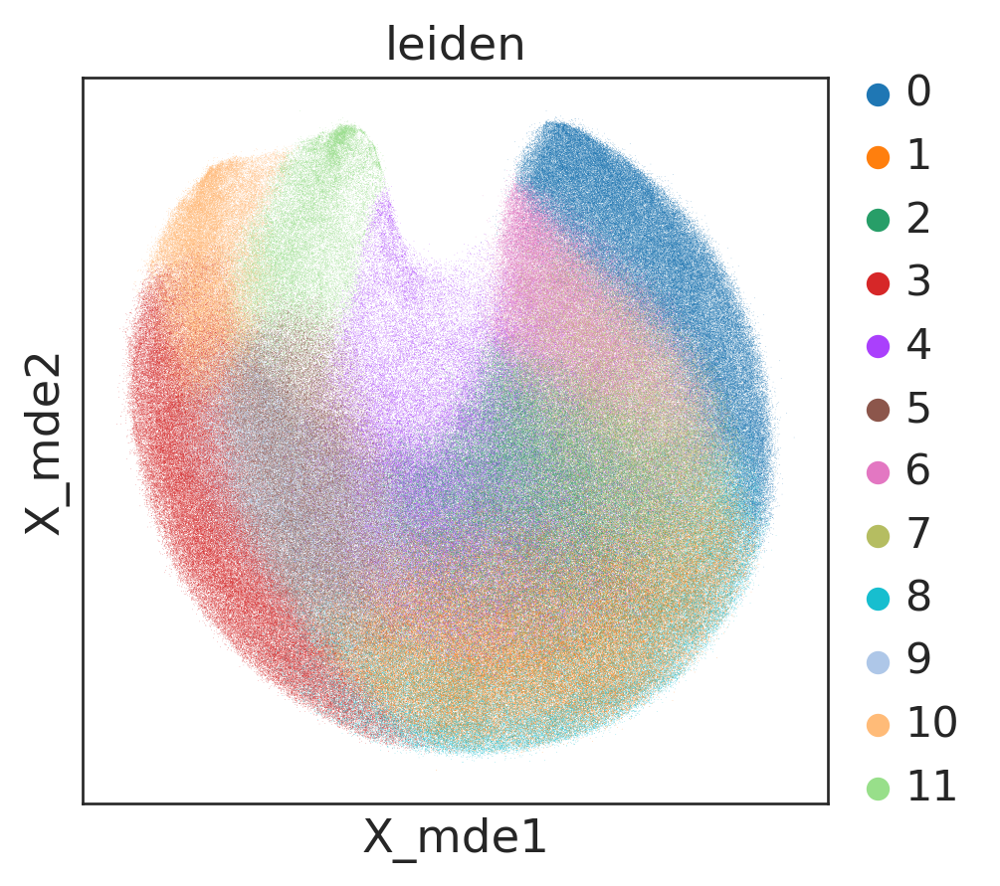

In [13]:
sc.pl.embedding(adata_08,basis='X_mde',color=['leiden'])

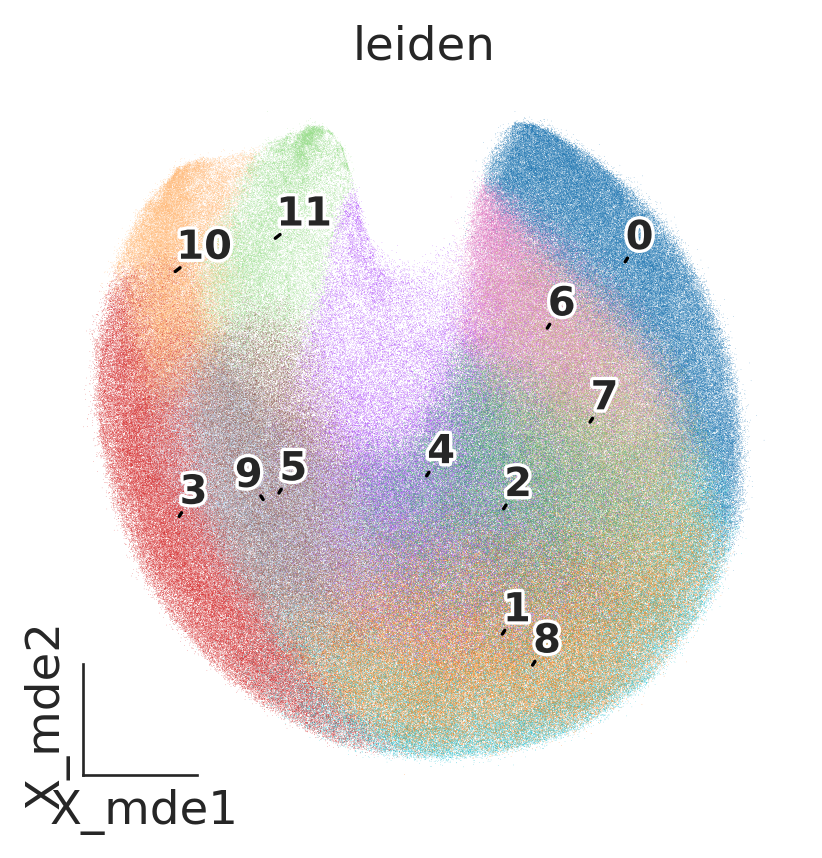

In [14]:
from matplotlib import patheffects
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4,4))

ov.pl.embedding(adata_08,
                  basis='X_mde',
                  color=['leiden'],
                   show=False, legend_loc=None, add_outline=False, 
                   frameon='small',legend_fontoutline=2,ax=ax
                 )

ov.pl.embedding_adjust(
    adata_08,
    groupby='leiden',
    exclude=("OL",),  
    basis='X_mde',
    ax=ax,
    adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
    text_kwargs=dict(fontsize=12 ,weight='bold',
                     path_effects=[patheffects.withStroke(linewidth=2, foreground='w')] ),
)

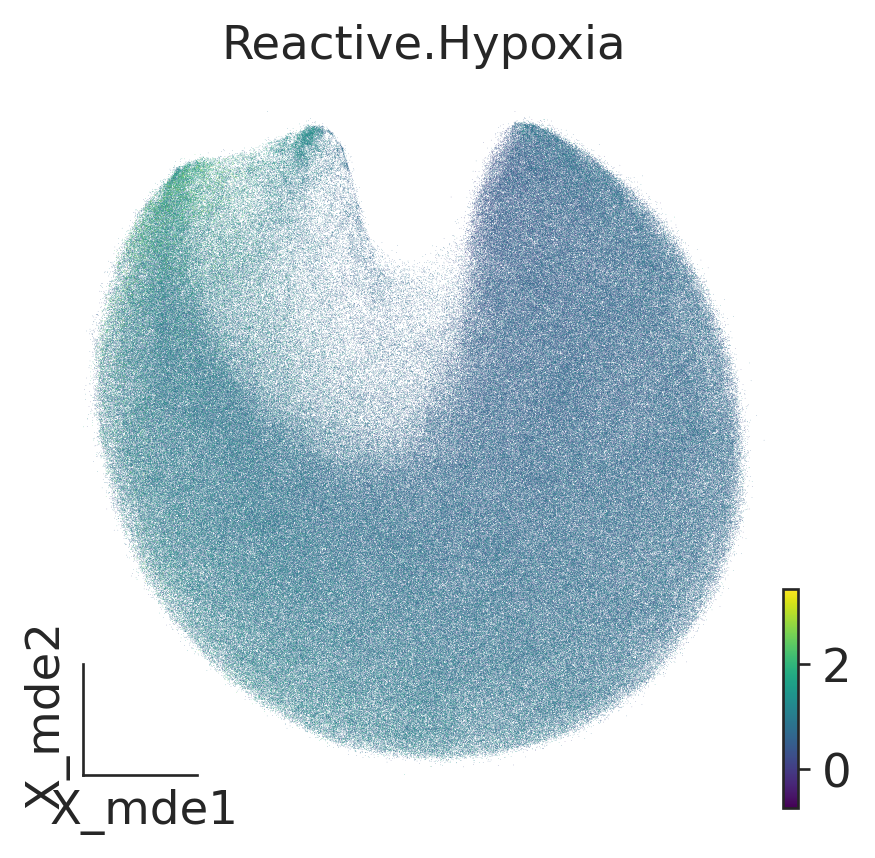

In [15]:
fig, ax = plt.subplots(figsize=(4,4))
ov.pl.embedding(adata_08,
                basis='X_mde',
                color=['Reactive.Hypoxia'],
                frameon='small',
                show=True,ax=ax,cmap='viridis')

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


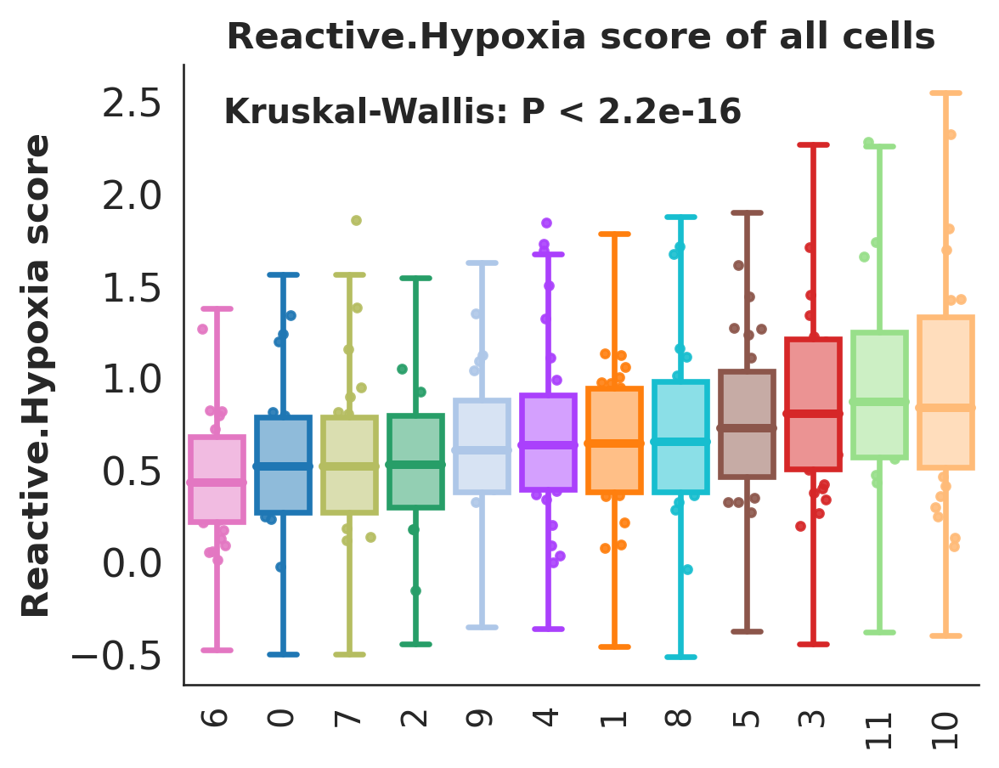

In [16]:
plot_boxplot(adata_08,groupby='leiden',
             var='Reactive.Hypoxia',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Reactive.Hypoxia score',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Reactive.Hypoxia score of all cells',
             save=False,
             )

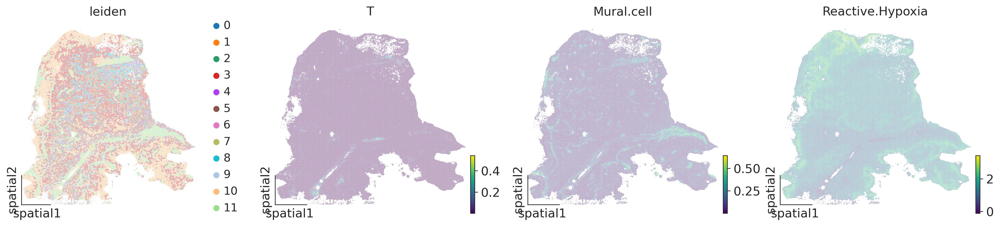

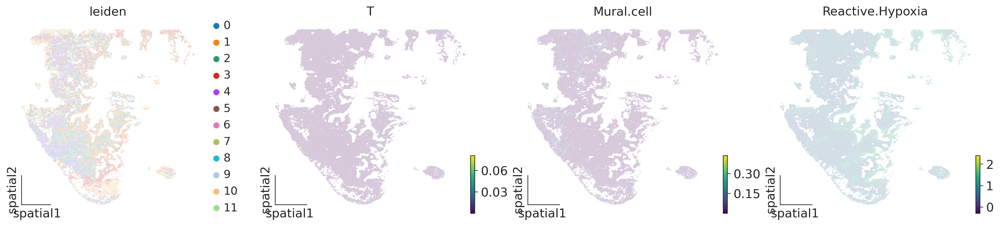

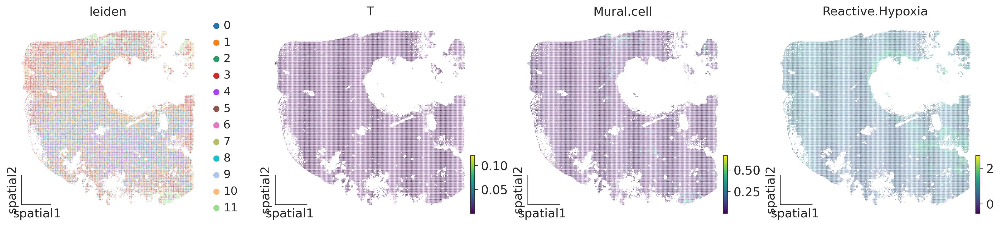

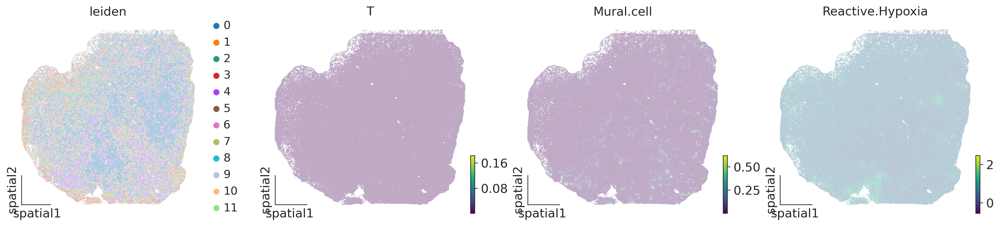

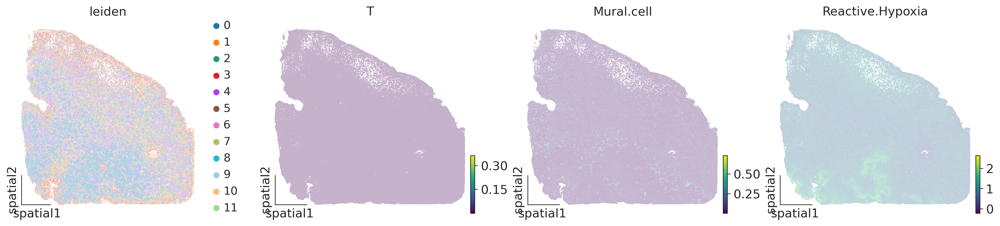

In [19]:
patient_set = ['LA_443_T','LSN_441_T','LYZ_442_T','LZT_426_T','ZJC_420_T']
for i in patient_set:
    ov.utils.embedding(adata_08[adata_08.obs['batch_name']==i],
                basis='spatial',
                color=['leiden','T','Mural.cell','Reactive.Hypoxia'],
                frameon='small',size=0.5,cmap='viridis'),

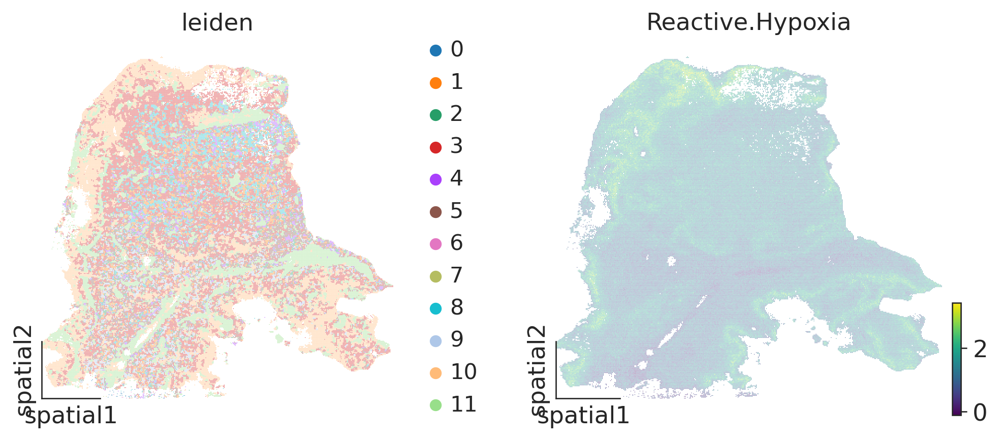

In [20]:
patient_set = ['LA_443_T']
for i in patient_set:
    ov.utils.embedding(adata_08[adata_08.obs['batch_name']==i],
                basis='spatial',
                color=['leiden','Reactive.Hypoxia'],
                frameon='small',size=0.5,cmap='viridis'),

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


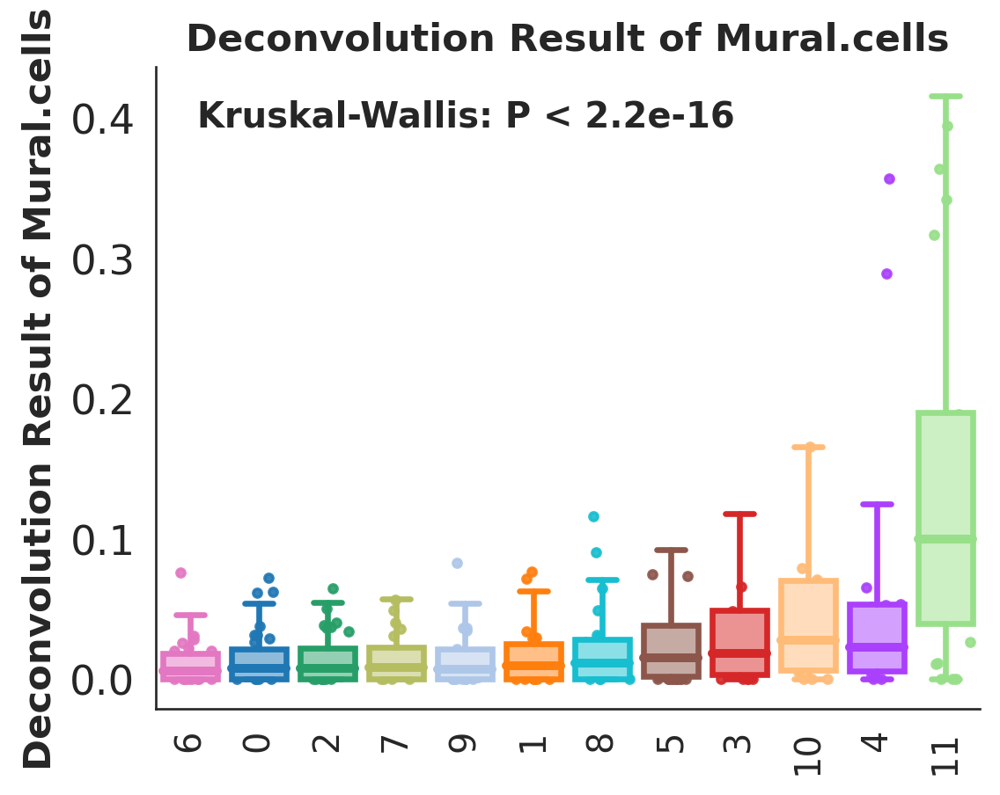

In [21]:
plot_boxplot(adata_08,groupby='leiden',
             var='Mural.cell',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Mural.cells',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Mural.cells',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


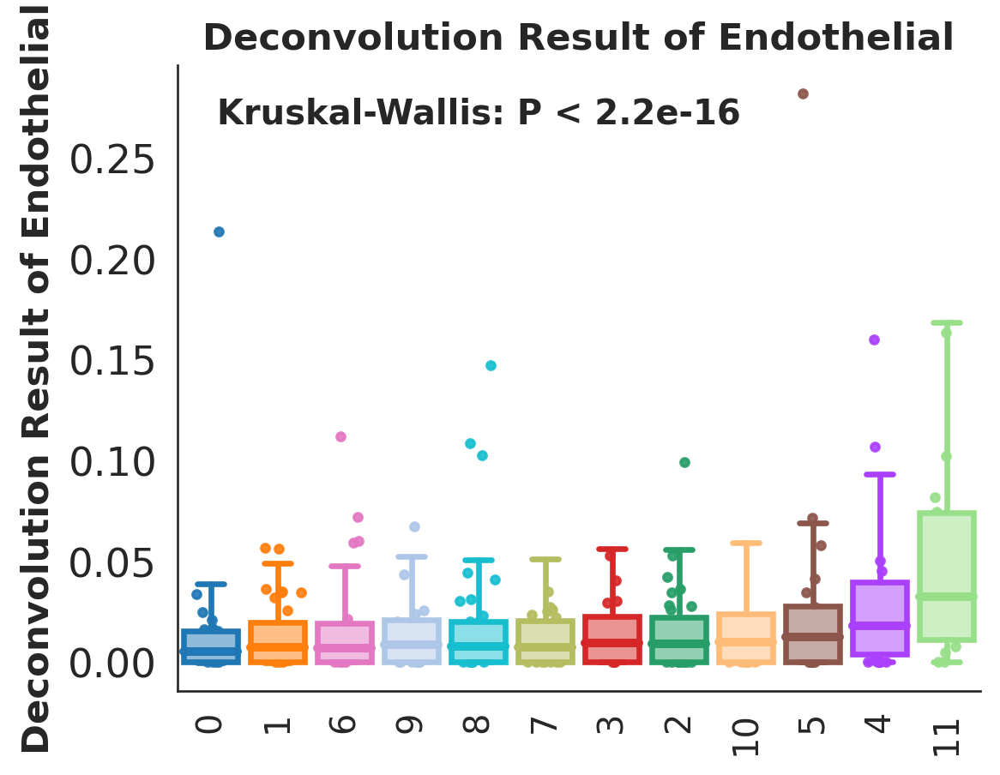

In [29]:
plot_boxplot(adata_08,groupby='leiden',
             var='Endothelial',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Endothelial',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Endothelial',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


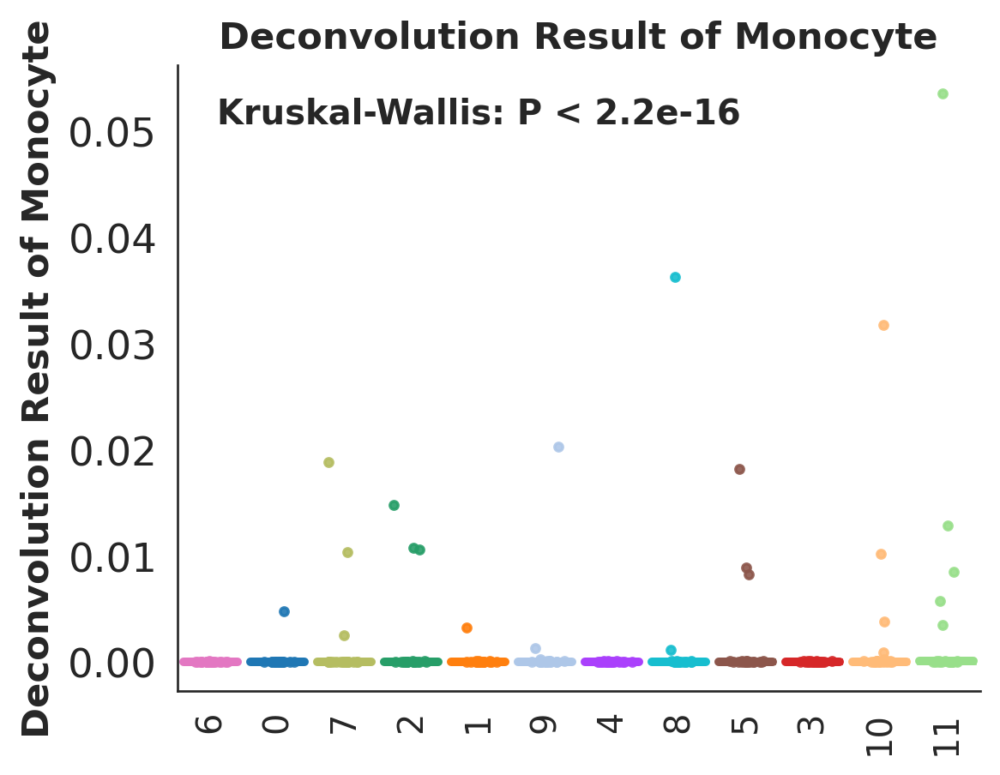

In [23]:
plot_boxplot(adata_08,groupby='leiden',
             var='Monocyte',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Monocyte',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Monocyte',
             save=False,
             )

In [36]:
adata_08

AnnData object with n_obs × n_vars = 1142215 × 25702
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_Spatial', 'nFeature_Spatial', 'percent.mito', 'x', 'y', 'nCount_SCT', 'nFeature_SCT', 'first_type', 'slice_name', 'batch_name', 'Reactive.Hypoxia', 'leiden', 'Anti.inflammatory.Macrophage', 'B', 'Cancer.cell', 'DC', 'Disease.Asscociated.Microglia', 'Endothelial', 'Homeostatic.Microglia', 'Hypoxic.Macrophage', 'Mast', 'Monocyte', 'Mural.cell', 'Neutrophil', 'NK', 'oligodendrocyte', 'pre.active.Microglia', 'T'
    uns: 'leiden_colors'
    obsm: 'STAligner', 'X_pca', 'spatial', 'X_mde'

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


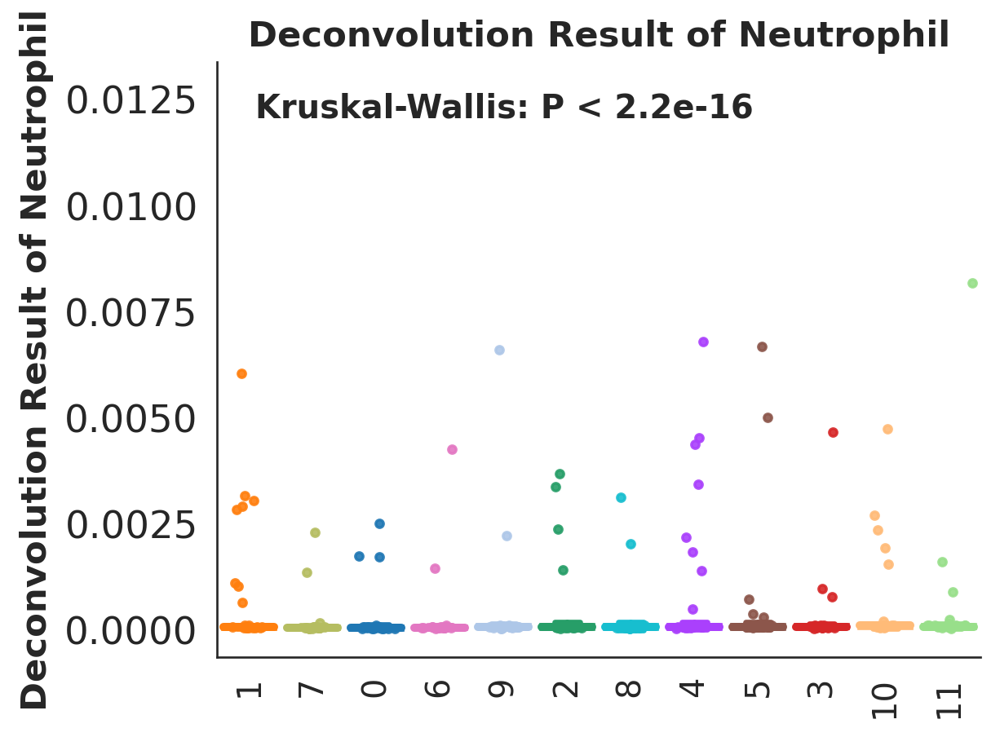

In [40]:
plot_boxplot(adata_08,groupby='leiden',
             var='Neutrophil',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Neutrophil',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Neutrophil',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


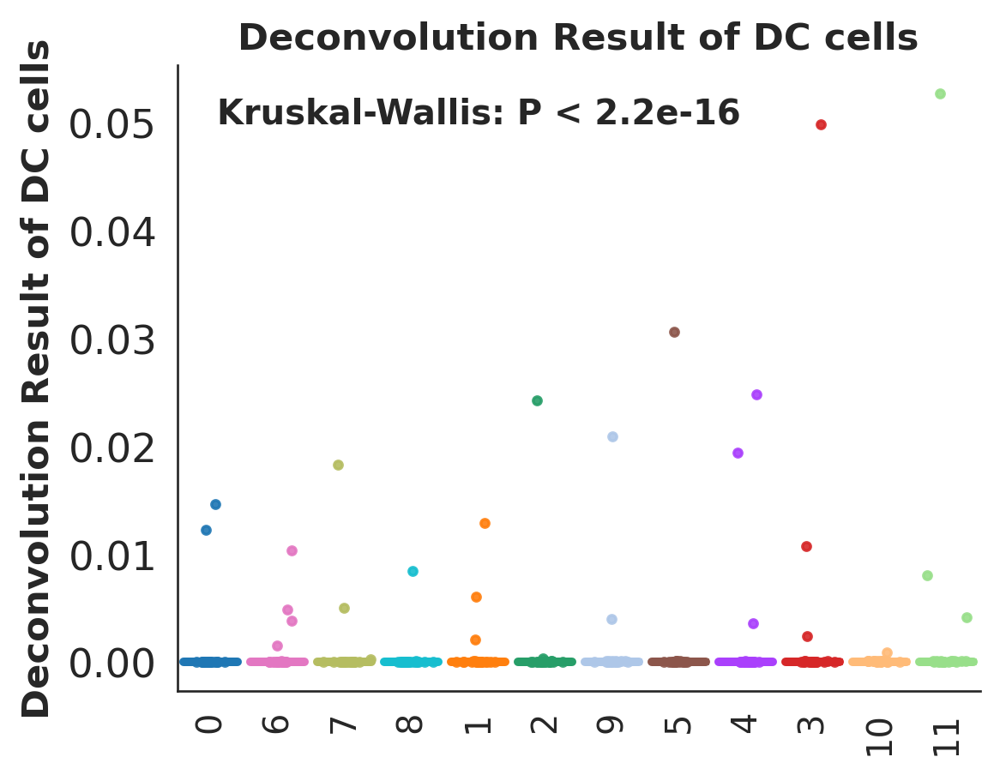

In [39]:
plot_boxplot(adata_08,groupby='leiden',
             var='DC',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of DC cells',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of DC cells',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


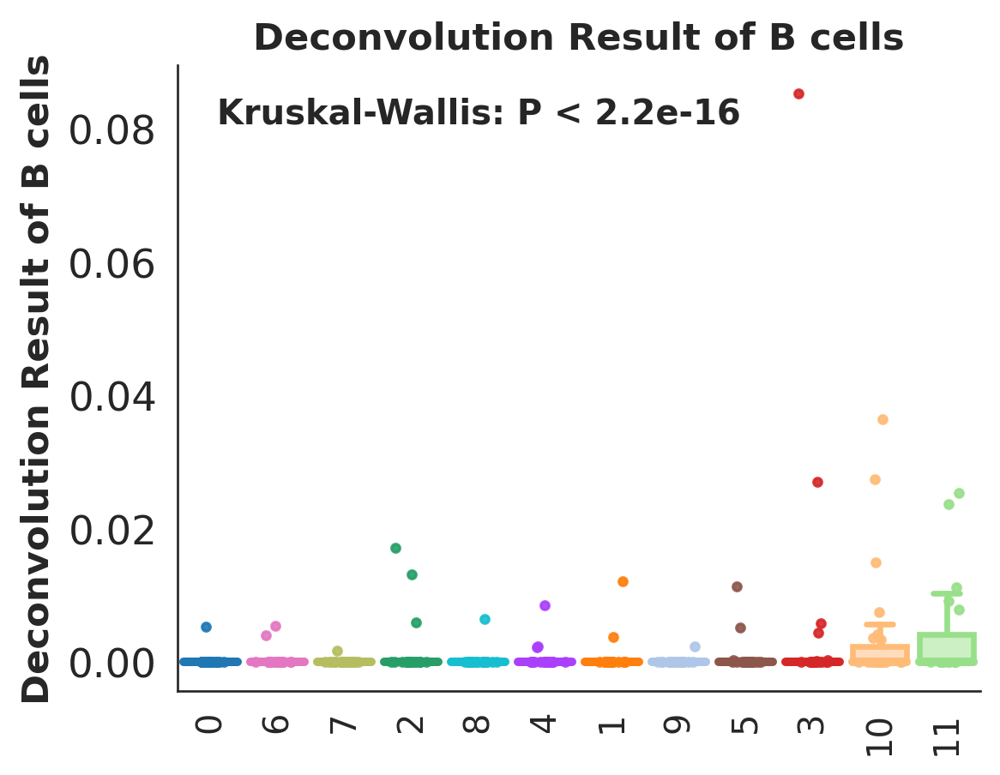

In [38]:
plot_boxplot(adata_08,groupby='leiden',
             var='B',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of B cells',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of B cells',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


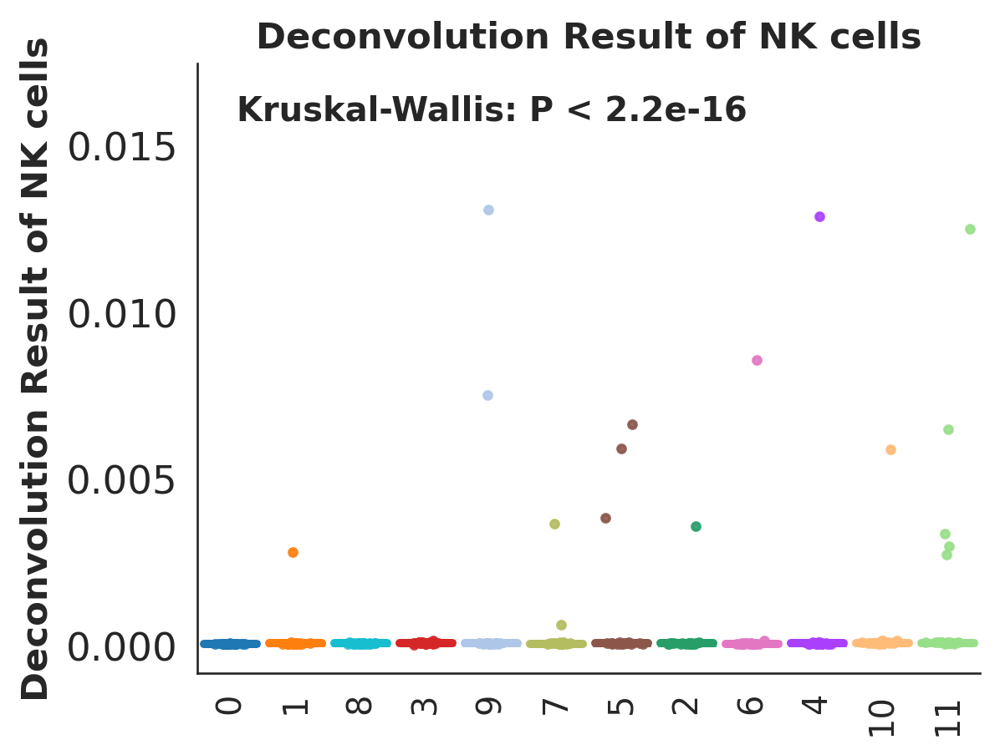

In [37]:
plot_boxplot(adata_08,groupby='leiden',
             var='NK',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of NK cells',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of NK cells',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


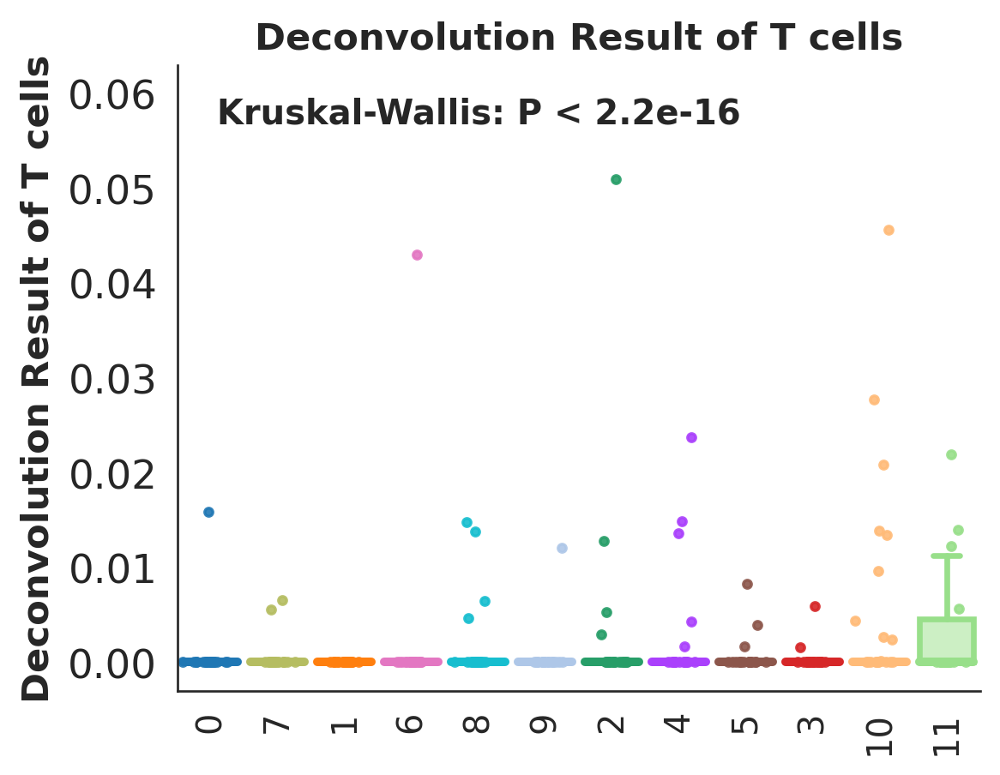

In [24]:
plot_boxplot(adata_08,groupby='leiden',
             var='T',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of T cells',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of T cells',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


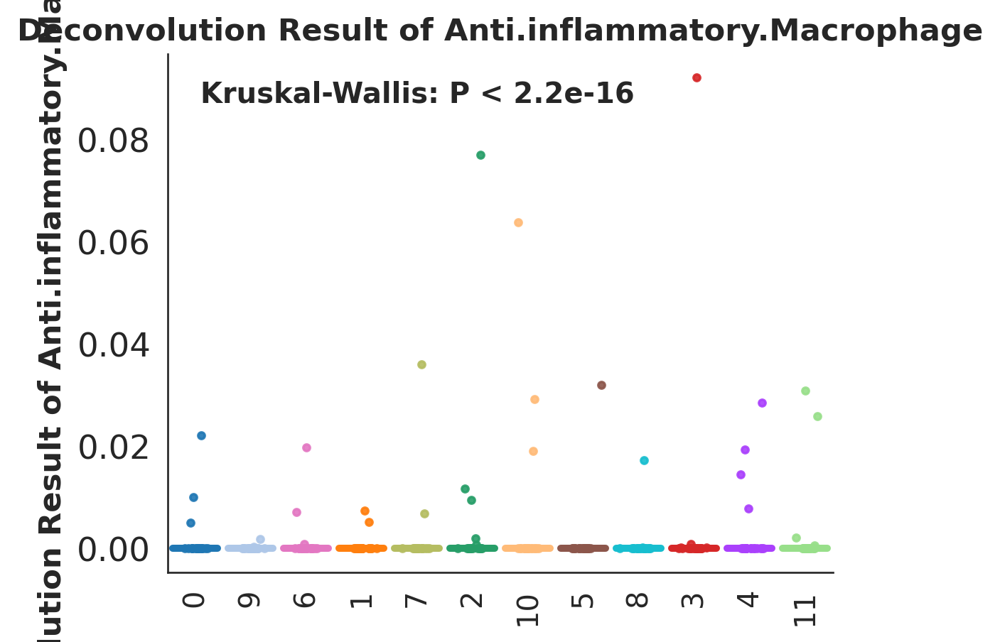

In [25]:
plot_boxplot(adata_08,groupby='leiden',
             var='Anti.inflammatory.Macrophage',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Anti.inflammatory.Macrophage',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Anti.inflammatory.Macrophage',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


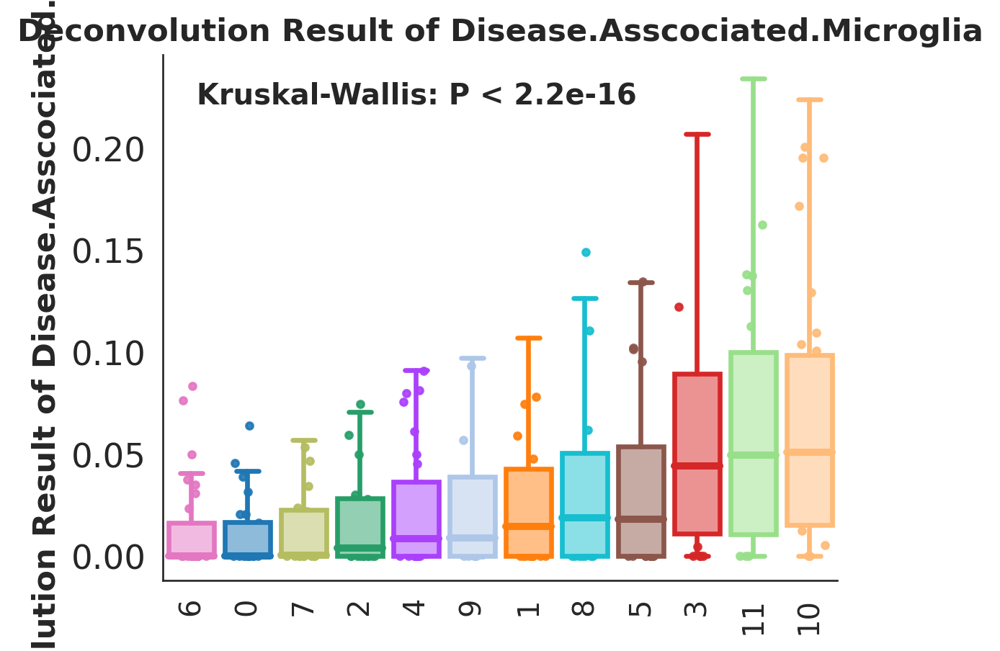

In [28]:
plot_boxplot(adata_08,groupby='leiden',
             var='Disease.Asscociated.Microglia',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Disease.Asscociated.Microglia',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Disease.Asscociated.Microglia',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


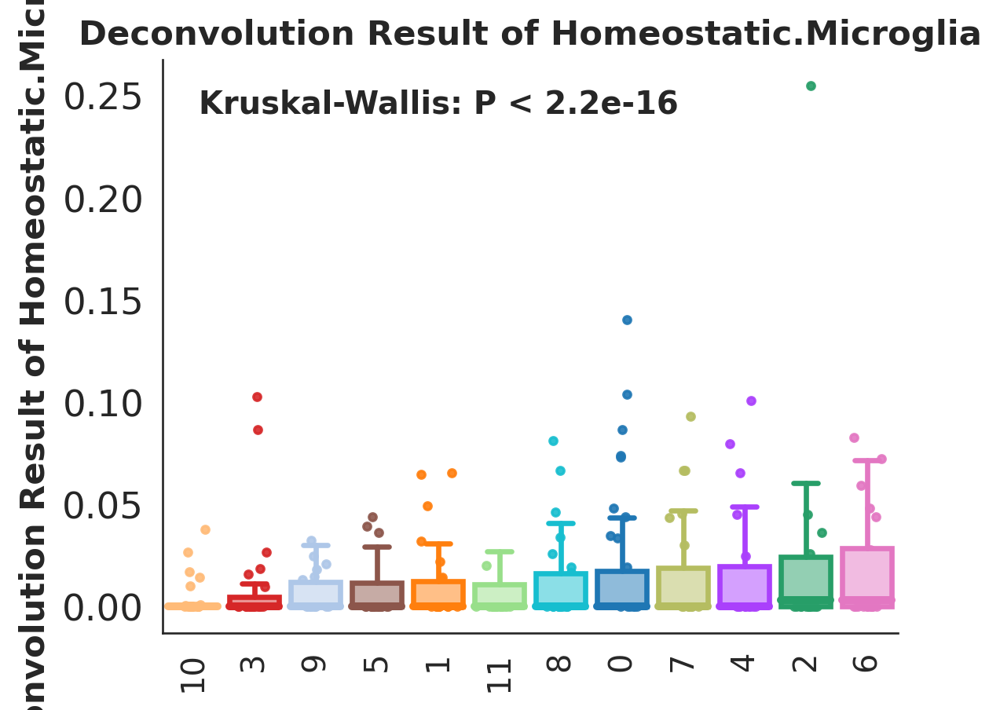

In [30]:
plot_boxplot(adata_08,groupby='leiden',
             var='Homeostatic.Microglia',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Homeostatic.Microglia',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Homeostatic.Microglia',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


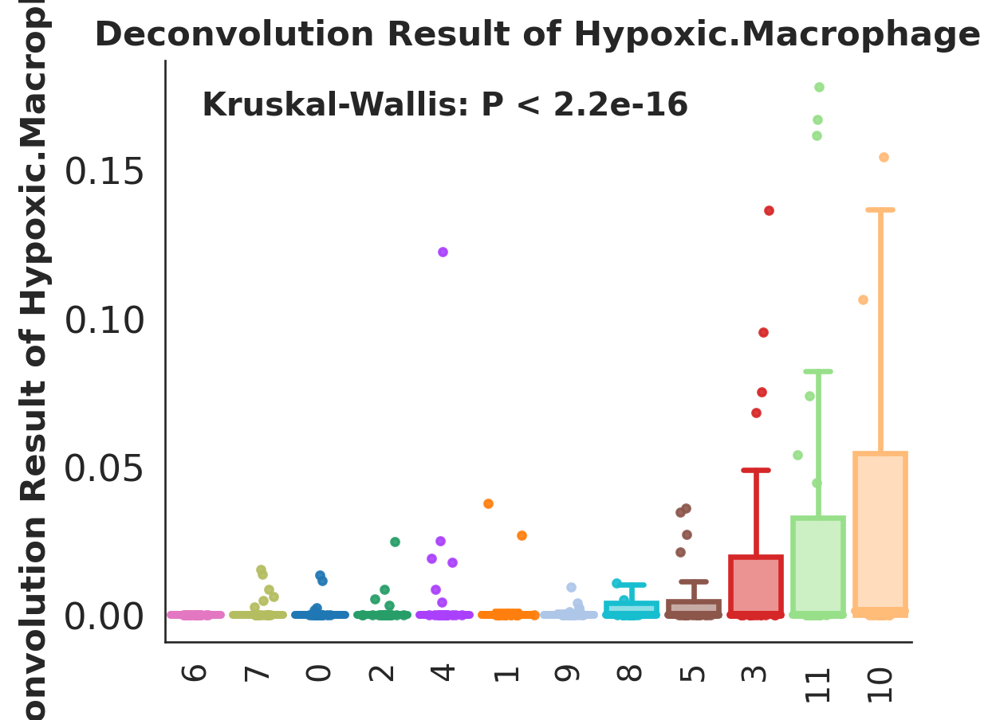

In [35]:
plot_boxplot(adata_08,groupby='leiden',
             var='Hypoxic.Macrophage',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Hypoxic.Macrophage',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Hypoxic.Macrophage',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


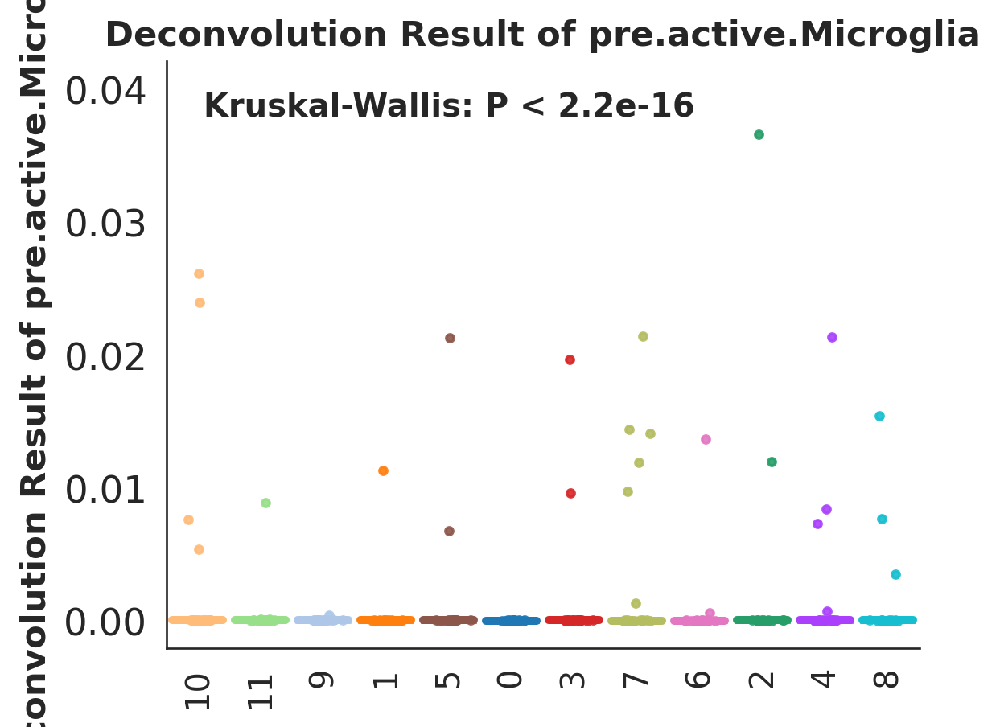

In [32]:
plot_boxplot(adata_08,groupby='leiden',
             var='pre.active.Microglia',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of pre.active.Microglia',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of pre.active.Microglia',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


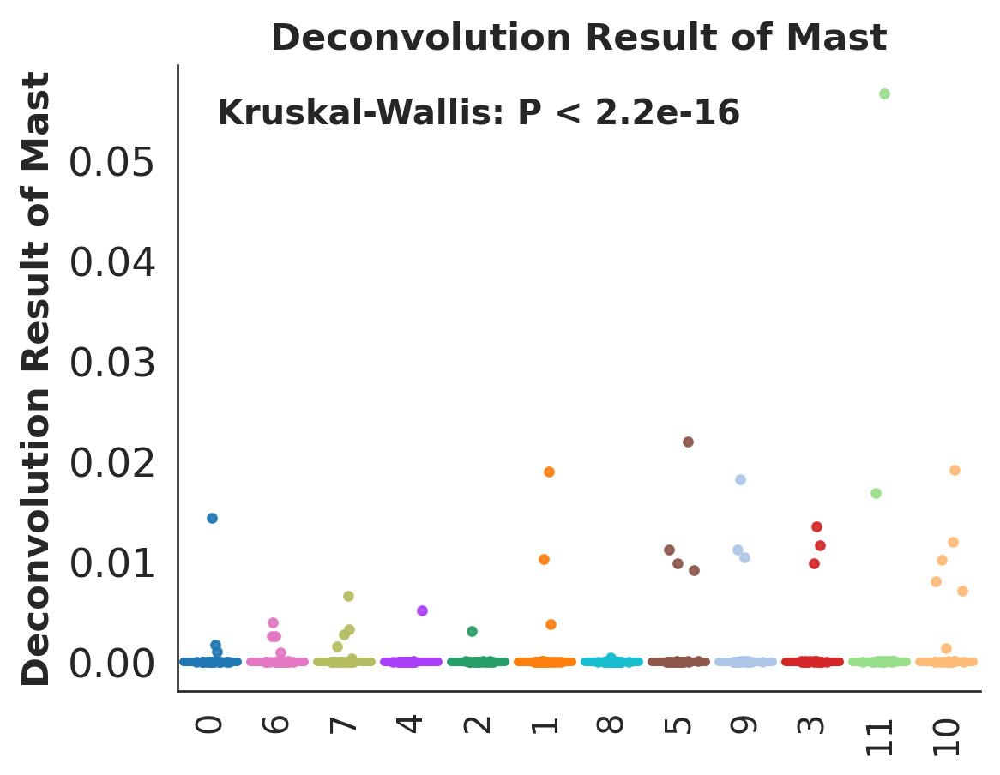

In [33]:
plot_boxplot(adata_08,groupby='leiden',
             var='Mast',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Mast',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Mast',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


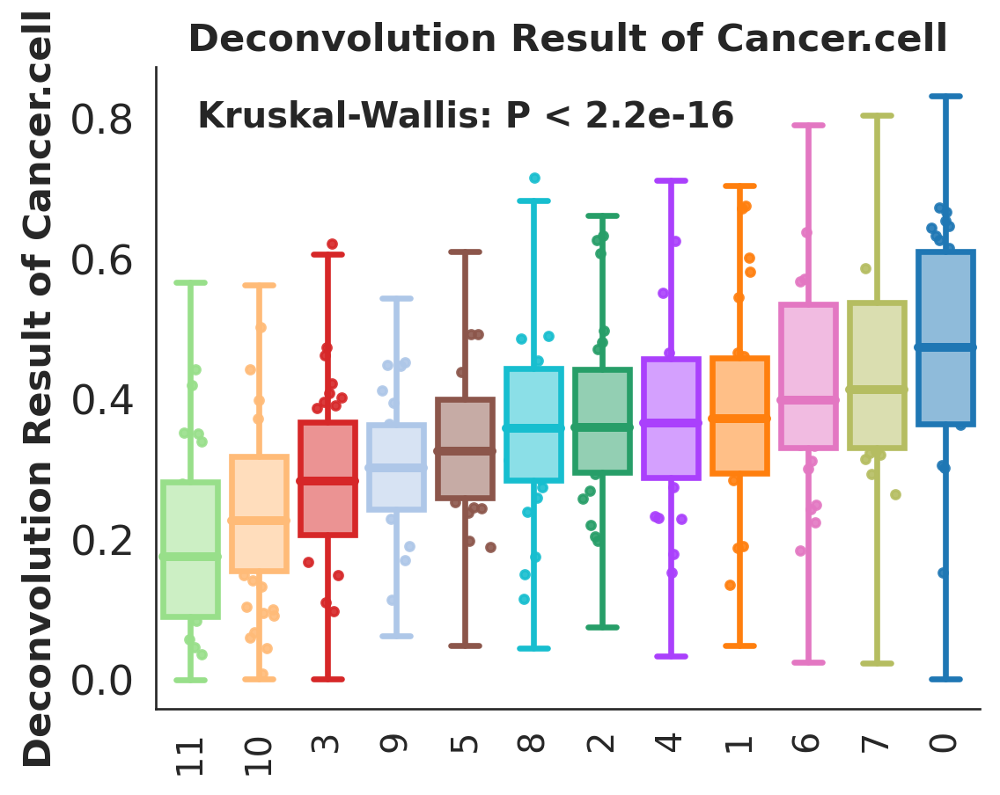

In [34]:
plot_boxplot(adata_08,groupby='leiden',
             var='Cancer.cell',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of Cancer.cell',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of Cancer.cell',
             save=False,
             )

{0: '#1f77b4', 1: '#ff7f0e', 2: '#279e68', 3: '#d62728', 4: '#aa40fc', 5: '#8c564b', 6: '#e377c2', 7: '#b5bd61', 8: '#17becf', 9: '#aec7e8', 10: '#ffbb78', 11: '#98df8a'}


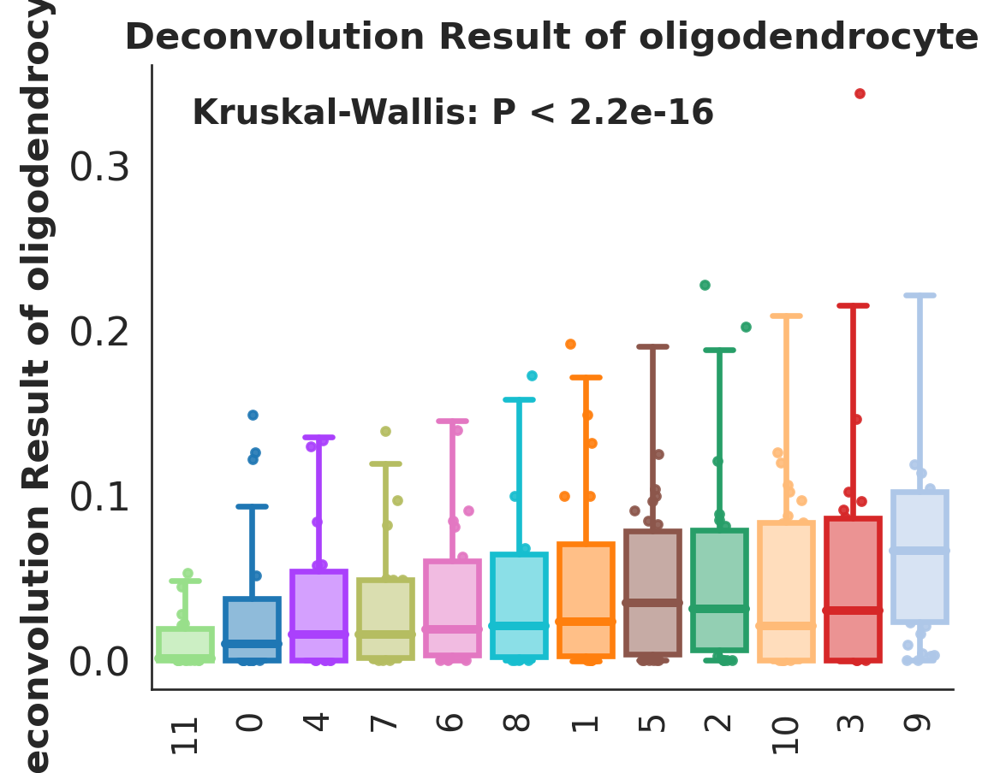

In [42]:
plot_boxplot(adata_08,groupby='leiden',
             var='oligodendrocyte',
             type_color_dict=dict(zip(pd.Categorical(adata_08.obs['leiden']).categories, adata_08.uns['leiden_colors'])),
             x_ticks_plot=True,
             figsize=(5,4),
             kruskal_test=True,
             ylabel='Deconvolution Result of oligodendrocyte',
             legend_plot=False,
             bbox_to_anchor=(1,1),
             title='Deconvolution Result of oligodendrocyte',
             save=False,
             )